<a href="https://colab.research.google.com/github/nicjm18/Prediccion-de-Accidentes/blob/main/Preparacion_de_Datos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Preparación de los datos para la predicción de gravedad de los accidentes

In [ ]:
#Importamos librerias para la preparación
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
#Leemos los datos
datos = pd.read_csv('Crash_Reporting_-_Drivers_Data.csv')
datos.head()

<ipython-input-5-6f0e20ae1248>:2: DtypeWarning: Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.
  datos = pd.read_csv('Crash_Reporting_-_Drivers_Data.csv')


,Report Number,Local Case Number,Agency Name,ACRS Report Type,Crash Date/Time,Route Type,Road Name,Cross-Street Type,Cross-Street Name,Off-Road Description,...,Speed Limit,Driverless Vehicle,Parked Vehicle,Vehicle Year,Vehicle Make,Vehicle Model,Equipment Problems,Latitude,Longitude,Location
0,MCP3040003N,190026050,Montgomery County Police,Property Damage Crash,05/31/2019 03:00:00 PM,NaN,NaN,NaN,NaN,PARKING LOT OF 3215 SPARTAN RD,...,15,No,No,2004,HONDA,TK,UNKNOWN,39.150044,-77.063089,"(39.15004368, -77.06308884)"
1,EJ78850038,230034791,Gaithersburg Police Depar,Property Damage Crash,07/21/2023 05:59:00 PM,Maryland (State),FREDERICK RD,Unknown,WATKINS MILL RD,NaN,...,40,No,No,2011,GMC,TK,NO MISUSE,39.159264,-77.219025,"(39.1592635, -77.21902483)"
2,MCP2009002G,230034583,Montgomery County Police,Property Damage Crash,07/20/2023 03:10:00 PM,Maryland (State),GEORGIA AVE,Maryland (State),NORBECK RD,NaN,...,35,No,No,2019,FORD,F150,NO MISUSE,39.109535,-77.075806,"(39.10953506, -77.07580619)"
3,MCP3201004C,230035036,Montgomery County Police,Property Damage Crash,07/23/2023 12:10:00 PM,County,CRYSTAL ROCK DR,County,WATERS LANDING DR,NaN,...,40,No,No,2016,KIA,SW,NO MISUSE,39.190149,-77.266766,"(39.19014917, -77.26676583)"
4,MCP23290028,230035152,Montgomery County Police,Property Damage Crash,07/24/2023 06:10:00 AM,County,MONTGOMERY VILLAGE AVE,County,CENTERWAY RD,NaN,...,35,No,No,2016,TOYT,TK,NO MISUSE,39.172558,-77.203745,"(39.17255801, -77.20374546)"


In [ ]:
#Obtenemos los datos de los accidentes ocurridos en el último año (2023)
from datetime import datetime

datos['Crash Date/Time'] = pd.to_datetime(datos['Crash Date/Time'], format='%m/%d/%Y %I:%M:%S %p')

# Filtrar las filas donde 'Crash Date/Time' sea mayor a '01/01/2023 00:00:00 AM'
fecha_referencia = datetime(2023, 1, 1)
data = datos[datos['Crash Date/Time'] > fecha_referencia]

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 18918 entries, 1 to 172061
Data columns (total 43 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   Report Number                   18918 non-null  object        
 1   Local Case Number               18918 non-null  object        
 2   Agency Name                     18918 non-null  object        
 3   ACRS Report Type                18918 non-null  object        
 4   Crash Date/Time                 18918 non-null  datetime64[ns]
 5   Route Type                      16935 non-null  object        
 6   Road Name                       17153 non-null  object        
 7   Cross-Street Type               16926 non-null  object        
 8   Cross-Street Name               17144 non-null  object        
 9   Off-Road Description            1765 non-null   object        
 10  Municipality                    2139 non-null   object        
 11  Relate

In [ ]:
#Transformamos los datos de tipo object a tipo category
object_columns = [
    'Report Number', 'Local Case Number', 'Agency Name', 'ACRS Report Type', 'Crash Date/Time',
    'Route Type', 'Road Name', 'Cross-Street Type', 'Cross-Street Name', 'Off-Road Description',
    'Municipality', 'Related Non-Motorist', 'Collision Type', 'Weather', 'Surface Condition',
    'Light', 'Traffic Control', 'Driver Substance Abuse', 'Non-Motorist Substance Abuse',
    'Person ID', 'Driver At Fault', 'Injury Severity', 'Circumstance', 'Driver Distracted By',
    'Drivers License State', 'Vehicle ID', 'Vehicle Damage Extent', 'Vehicle First Impact Location',
    'Vehicle Second Impact Location', 'Vehicle Body Type', 'Vehicle Movement', 'Vehicle Continuing Dir',
    'Vehicle Going Dir', 'Driverless Vehicle', 'Parked Vehicle', 'Vehicle Make', 'Vehicle Model',
    'Equipment Problems', 'Location'
]

# Convertir columnas de tipo object a category
for col in object_columns:
    data[col] = data[col].astype('category')

<ipython-input-8-9011ce421948>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[col] = data[col].astype('category')
<ipython-input-8-9011ce421948>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[col] = data[col].astype('category')
<ipython-input-8-9011ce421948>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/u

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 18918 entries, 1 to 172061
Data columns (total 43 columns):
 #   Column                          Non-Null Count  Dtype   
---  ------                          --------------  -----   
 0   Report Number                   18918 non-null  category
 1   Local Case Number               18918 non-null  category
 2   Agency Name                     18918 non-null  category
 3   ACRS Report Type                18918 non-null  category
 4   Crash Date/Time                 18918 non-null  category
 5   Route Type                      16935 non-null  category
 6   Road Name                       17153 non-null  category
 7   Cross-Street Type               16926 non-null  category
 8   Cross-Street Name               17144 non-null  category
 9   Off-Road Description            1765 non-null   category
 10  Municipality                    2139 non-null   category
 11  Related Non-Motorist            655 non-null    category
 12  Collision Type        

#Eliminacion de variables repetidas, redundantes o irrelevantes

In [ ]:
data = data.drop(["Person ID", "Agency Name", "Vehicle ID", "Report Number", "Local Case Number", "Road Name", "Cross-Street Name", "Off-Road Description", "Municipality"], axis =1)
data.head()

,ACRS Report Type,Crash Date/Time,Route Type,Cross-Street Type,Related Non-Motorist,Collision Type,Weather,Surface Condition,Light,Traffic Control,...,Speed Limit,Driverless Vehicle,Parked Vehicle,Vehicle Year,Vehicle Make,Vehicle Model,Equipment Problems,Latitude,Longitude,Location
1,Property Damage Crash,2023-07-21 17:59:00,Maryland (State),Unknown,NaN,STRAIGHT MOVEMENT ANGLE,CLEAR,DRY,DAYLIGHT,TRAFFIC SIGNAL,...,40,No,No,2011,GMC,TK,NO MISUSE,39.159264,-77.219025,"(39.1592635, -77.21902483)"
2,Property Damage Crash,2023-07-20 15:10:00,Maryland (State),Maryland (State),NaN,STRAIGHT MOVEMENT ANGLE,CLEAR,DRY,DAYLIGHT,TRAFFIC SIGNAL,...,35,No,No,2019,FORD,F150,NO MISUSE,39.109535,-77.075806,"(39.10953506, -77.07580619)"
3,Property Damage Crash,2023-07-23 12:10:00,County,County,NaN,STRAIGHT MOVEMENT ANGLE,CLEAR,DRY,DAYLIGHT,NO CONTROLS,...,40,No,No,2016,KIA,SW,NO MISUSE,39.190149,-77.266766,"(39.19014917, -77.26676583)"
4,Property Damage Crash,2023-07-24 06:10:00,County,County,NaN,HEAD ON LEFT TURN,CLOUDY,DRY,DAYLIGHT,TRAFFIC SIGNAL,...,35,No,No,2016,TOYT,TK,NO MISUSE,39.172558,-77.203745,"(39.17255801, -77.20374546)"
5,Property Damage Crash,2023-07-11 07:40:00,County,County,NaN,SAME DIR REAR END,CLEAR,DRY,DAYLIGHT,NO CONTROLS,...,30,No,No,2016,GILL,BUS,NO MISUSE,38.994498,-77.027334,"(38.99449791, -77.02733407)"


In [ ]:
data = data.drop(["Latitude", "Circumstance","Driverless Vehicle", "Vehicle Going Dir", "Vehicle Continuing Dir", "Related Non-Motorist", "Longitude", "Location", "Weather", "Crash Date/Time", "Vehicle Year", "Vehicle Make", "Vehicle Model", "Drivers License State"], axis =1)
data.head()

,ACRS Report Type,Route Type,Cross-Street Type,Collision Type,Surface Condition,Light,Traffic Control,Driver Substance Abuse,Non-Motorist Substance Abuse,Driver At Fault,Injury Severity,Driver Distracted By,Vehicle Damage Extent,Vehicle First Impact Location,Vehicle Second Impact Location,Vehicle Body Type,Vehicle Movement,Speed Limit,Parked Vehicle,Equipment Problems
1,Property Damage Crash,Maryland (State),Unknown,STRAIGHT MOVEMENT ANGLE,DRY,DAYLIGHT,TRAFFIC SIGNAL,NONE DETECTED,NaN,No,NO APPARENT INJURY,NOT DISTRACTED,DISABLING,THREE OCLOCK,TWO OCLOCK,PASSENGER CAR,MAKING LEFT TURN,40,No,NO MISUSE
2,Property Damage Crash,Maryland (State),Maryland (State),STRAIGHT MOVEMENT ANGLE,DRY,DAYLIGHT,TRAFFIC SIGNAL,NONE DETECTED,NaN,Yes,NO APPARENT INJURY,NOT DISTRACTED,FUNCTIONAL,TWELVE OCLOCK,TWELVE OCLOCK,PICKUP TRUCK,ACCELERATING,35,No,NO MISUSE
3,Property Damage Crash,County,County,STRAIGHT MOVEMENT ANGLE,DRY,DAYLIGHT,NO CONTROLS,NONE DETECTED,NaN,Yes,NO APPARENT INJURY,LOOKED BUT DID NOT SEE,FUNCTIONAL,TWELVE OCLOCK,TWELVE OCLOCK,PASSENGER CAR,STARTING FROM LANE,40,No,NO MISUSE
4,Property Damage Crash,County,County,HEAD ON LEFT TURN,DRY,DAYLIGHT,TRAFFIC SIGNAL,NONE DETECTED,NaN,Yes,NO APPARENT INJURY,NOT DISTRACTED,FUNCTIONAL,TWELVE OCLOCK,TWELVE OCLOCK,(SPORT) UTILITY VEHICLE,MAKING LEFT TURN,35,No,NO MISUSE
5,Property Damage Crash,County,County,SAME DIR REAR END,DRY,DAYLIGHT,NO CONTROLS,NONE DETECTED,NaN,No,NO APPARENT INJURY,NOT DISTRACTED,FUNCTIONAL,SIX OCLOCK,SIX OCLOCK,TRANSIT BUS,STOPPED IN TRAFFIC LANE,30,No,NO MISUSE


In [ ]:
data = data.drop(["Non-Motorist Substance Abuse"], axis=1)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 18918 entries, 1 to 172061
Data columns (total 19 columns):
 #   Column                          Non-Null Count  Dtype   
---  ------                          --------------  -----   
 0   ACRS Report Type                18918 non-null  category
 1   Route Type                      16935 non-null  category
 2   Cross-Street Type               16926 non-null  category
 3   Collision Type                  18842 non-null  category
 4   Surface Condition               16780 non-null  category
 5   Light                           18751 non-null  category
 6   Traffic Control                 16617 non-null  category
 7   Driver Substance Abuse          15451 non-null  category
 8   Driver At Fault                 18918 non-null  category
 9   Injury Severity                 18918 non-null  category
 10  Driver Distracted By            18918 non-null  category
 11  Vehicle Damage Extent           18875 non-null  category
 12  Vehicle First Impact L

### Analisis Estadistico de las Variables

In [ ]:
data.describe()

,Speed Limit
count,18918.000000
mean,31.646316
std,10.956768
min,0.000000
25%,25.000000
50%,35.000000
75%,40.000000
max,75.000000


<Axes: ylabel='Speed Limit'>

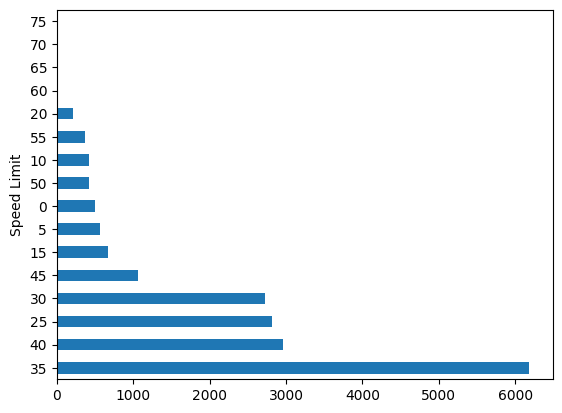

In [ ]:
data['Speed Limit'].value_counts().plot(kind="barh")

array([[<Axes: title={'center': 'Speed Limit'}>]], dtype=object)

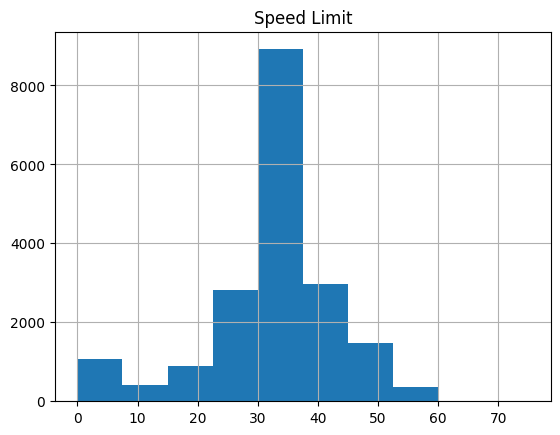

In [ ]:
data.hist()

<Axes: >

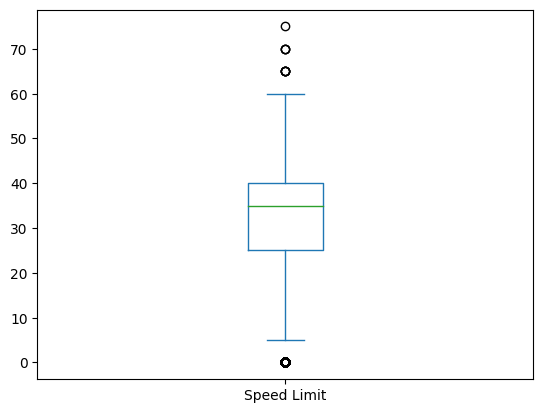

In [ ]:
data.plot.box()

In [ ]:
!pip install ydata-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 359.5/359.5 kB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 11.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 12.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 32.5 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27080 sha256=10fa4a5234efaa7246063d8ebd167be016c44d93eee3981b21c90340060b467d
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [ ]:
from ydata_profiling import ProfileReport
profile_data= ProfileReport(data,minimal= True)
profile_data

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

###Limpieza de Atipicos y Nulos

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 18918 entries, 1 to 172061
Data columns (total 19 columns):
 #   Column                          Non-Null Count  Dtype   
---  ------                          --------------  -----   
 0   ACRS Report Type                18918 non-null  category
 1   Route Type                      16935 non-null  category
 2   Cross-Street Type               16926 non-null  category
 3   Collision Type                  18842 non-null  category
 4   Surface Condition               16780 non-null  category
 5   Light                           18751 non-null  category
 6   Traffic Control                 16617 non-null  category
 7   Driver Substance Abuse          15451 non-null  category
 8   Driver At Fault                 18918 non-null  category
 9   Injury Severity                 18918 non-null  category
 10  Driver Distracted By            18918 non-null  category
 11  Vehicle Damage Extent           18875 non-null  category
 12  Vehicle First Impact L

In [ ]:
from sklearn.impute import SimpleImputer

# Imputación de variables numéricas por la media
ImpNumeros = SimpleImputer(missing_values=np.nan, strategy='median')
data[["Speed Limit"]] = ImpNumeros.fit_transform(data[["Speed Limit"]])

# Imputación de variables categóricas por la moda
ImpCategorias = SimpleImputer(missing_values=np.nan, strategy='most_frequent')
data[['Route Type', 'Cross-Street Type', 'Collision Type', 'Surface Condition',
      'Light', 'Traffic Control', 'Driver Substance Abuse','Vehicle Damage Extent', 'Vehicle First Impact Location',
      'Vehicle Second Impact Location', 'Vehicle Body Type', 'Vehicle Movement', 'Equipment Problems']] = ImpCategorias.fit_transform(data[['Route Type', 'Cross-Street Type', 'Collision Type', 'Surface Condition',
      'Light', 'Traffic Control', 'Driver Substance Abuse','Vehicle Damage Extent', 'Vehicle First Impact Location',
      'Vehicle Second Impact Location', 'Vehicle Body Type', 'Vehicle Movement', 'Equipment Problems']])


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 18918 entries, 1 to 172061
Data columns (total 19 columns):
 #   Column                          Non-Null Count  Dtype   
---  ------                          --------------  -----   
 0   ACRS Report Type                18918 non-null  category
 1   Route Type                      18918 non-null  object  
 2   Cross-Street Type               18918 non-null  object  
 3   Collision Type                  18918 non-null  object  
 4   Surface Condition               18918 non-null  object  
 5   Light                           18918 non-null  object  
 6   Traffic Control                 18918 non-null  object  
 7   Driver Substance Abuse          18918 non-null  object  
 8   Driver At Fault                 18918 non-null  category
 9   Injury Severity                 18918 non-null  category
 10  Driver Distracted By            18918 non-null  category
 11  Vehicle Damage Extent           18918 non-null  object  
 12  Vehicle First Impact L

In [ ]:
print(ImpNumeros.statistics_)
print(ImpCategorias.statistics_)

[35.]
['Maryland (State)' 'County' 'SAME DIR REAR END' 'DRY' 'DAYLIGHT'
 'NO CONTROLS' 'NONE DETECTED' 'DISABLING' 'TWELVE OCLOCK' 'TWELVE OCLOCK'
 'PASSENGER CAR' 'MOVING CONSTANT SPEED' 'NO MISUSE']


In [ ]:
df = data.copy()

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 18918 entries, 1 to 172061
Data columns (total 19 columns):
 #   Column                          Non-Null Count  Dtype   
---  ------                          --------------  -----   
 0   ACRS Report Type                18918 non-null  category
 1   Route Type                      18918 non-null  object  
 2   Cross-Street Type               18918 non-null  object  
 3   Collision Type                  18918 non-null  object  
 4   Surface Condition               18918 non-null  object  
 5   Light                           18918 non-null  object  
 6   Traffic Control                 18918 non-null  object  
 7   Driver Substance Abuse          18918 non-null  object  
 8   Driver At Fault                 18918 non-null  category
 9   Injury Severity                 18918 non-null  category
 10  Driver Distracted By            18918 non-null  category
 11  Vehicle Damage Extent           18918 non-null  object  
 12  Vehicle First Impact L

### Analisis de Correlaciones

In [ ]:
#Hacemos dummies de las variables categoricas para tenerlas como datos numericos
df_num= pd.get_dummies(df)
df_num.head()

,Speed Limit,ACRS Report Type_Fatal Crash,ACRS Report Type_Injury Crash,ACRS Report Type_Property Damage Crash,Route Type_County,Route Type_Government,Route Type_Interstate (State),Route Type_Maryland (State),Route Type_Municipality,Route Type_Other Public Roadway,...,Parked Vehicle_No,Parked Vehicle_Yes,Equipment Problems_AIR BAG FAILED,Equipment Problems_BELT(S) MISUSED,Equipment Problems_NO MISUSE,Equipment Problems_NOT STREPPED RIGHT,Equipment Problems_OTHER,Equipment Problems_SIZE/TYPE IMPROPER,Equipment Problems_STRAP/TETHER LOOSE,Equipment Problems_UNKNOWN
1,40.0,False,False,True,False,False,False,True,False,False,...,True,False,False,False,True,False,False,False,False,False
2,35.0,False,False,True,False,False,False,True,False,False,...,True,False,False,False,True,False,False,False,False,False
3,40.0,False,False,True,True,False,False,False,False,False,...,True,False,False,False,True,False,False,False,False,False
4,35.0,False,False,True,True,False,False,False,False,False,...,True,False,False,False,True,False,False,False,False,False
5,30.0,False,False,True,True,False,False,False,False,False,...,True,False,False,False,True,False,False,False,False,False


In [ ]:
df_num.corr()

,Speed Limit,ACRS Report Type_Fatal Crash,ACRS Report Type_Injury Crash,ACRS Report Type_Property Damage Crash,Route Type_County,Route Type_Government,Route Type_Interstate (State),Route Type_Maryland (State),Route Type_Municipality,Route Type_Other Public Roadway,...,Parked Vehicle_No,Parked Vehicle_Yes,Equipment Problems_AIR BAG FAILED,Equipment Problems_BELT(S) MISUSED,Equipment Problems_NO MISUSE,Equipment Problems_NOT STREPPED RIGHT,Equipment Problems_OTHER,Equipment Problems_SIZE/TYPE IMPROPER,Equipment Problems_STRAP/TETHER LOOSE,Equipment Problems_UNKNOWN
Speed Limit,1.000000,0.030303,0.144343,-0.147186,0.022612,-0.013287,0.230781,-0.106370,-0.097439,-0.018365,...,0.211693,-0.211693,-0.009351,0.012532,0.124763,0.002225,0.005265,-0.001092,-0.001545,-0.125757
ACRS Report Type_Fatal Crash,0.030303,1.000000,-0.033829,-0.068551,-0.003922,-0.001892,-0.005689,0.000660,-0.001872,-0.004032,...,0.006139,-0.006139,-0.001405,-0.000496,-0.005772,-0.000351,-0.001266,-0.000351,-0.000496,0.006119
ACRS Report Type_Injury Crash,0.144343,-0.033829,1.000000,-0.994758,0.009310,0.001298,0.003602,0.007403,-0.025738,-0.004250,...,0.055829,-0.055829,0.018309,-0.007204,0.109495,0.010377,-0.005496,-0.005094,0.014676,-0.112093
ACRS Report Type_Property Damage Crash,-0.147186,-0.068551,-0.994758,1.000000,-0.008893,-0.001102,-0.003013,-0.007457,0.025884,0.004655,...,-0.056358,0.056358,-0.018133,0.007242,-0.108710,-0.010323,0.005616,0.005121,-0.014599,0.111268
Route Type_County,0.022612,-0.003922,0.009310,-0.008893,1.000000,-0.027733,-0.083388,-0.764765,-0.169489,-0.059102,...,0.029080,-0.029080,0.006401,-0.007278,0.026530,-0.005146,0.002828,-0.005146,0.003625,-0.027246
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Equipment Problems_NOT STREPPED RIGHT,0.002225,-0.000351,0.010377,-0.010323,-0.005146,-0.000285,-0.000857,0.006729,-0.001741,-0.000607,...,0.000924,-0.000924,-0.000212,-0.000075,-0.021760,1.000000,-0.000191,-0.000053,-0.000075,-0.002404
Equipment Problems_OTHER,0.005265,-0.001266,-0.005496,0.005616,0.002828,-0.001027,0.014269,-0.004056,-0.006280,-0.002190,...,-0.012786,0.012786,-0.000763,-0.000270,-0.078480,-0.000191,1.000000,-0.000191,-0.000270,-0.008672
Equipment Problems_SIZE/TYPE IMPROPER,-0.001092,-0.000351,-0.005094,0.005121,-0.005146,-0.000285,-0.000857,-0.007856,-0.001741,-0.000607,...,0.000924,-0.000924,-0.000212,-0.000075,-0.021760,-0.000053,-0.000191,1.000000,-0.000075,-0.002404
Equipment Problems_STRAP/TETHER LOOSE,-0.001545,-0.000496,0.014676,-0.014599,0.003625,-0.000403,-0.001211,-0.000797,-0.002462,-0.000859,...,0.001307,-0.001307,-0.000299,-0.000106,-0.030774,-0.000075,-0.000270,-0.000075,1.000000,-0.003400


In [ ]:
corr_matrix = df_num.corr()

# Crear el heatmap con seaborn
plt.figure(figsize= (90, 90))  # Ajustar el tamaño de la figura según sea necesario
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', center=0)

# Mostrar el gráfico
plt.show()

In [ ]:
correlaciones = df_num.corr()
correlaciones_interesantes = correlaciones[(correlaciones > 0.6) | (correlaciones < -0.4)]

In [ ]:
#La variable injury severity tiene alta correlacion con la variable objetivo entonces se elimina
data = data.drop('Injury Severity', axis = 1)
data.head()

,ACRS Report Type,Route Type,Cross-Street Type,Collision Type,Surface Condition,Light,Traffic Control,Driver Substance Abuse,Driver At Fault,Driver Distracted By,Vehicle Damage Extent,Vehicle First Impact Location,Vehicle Second Impact Location,Vehicle Body Type,Vehicle Movement,Speed Limit,Parked Vehicle,Equipment Problems
1,Property Damage Crash,Maryland (State),Unknown,STRAIGHT MOVEMENT ANGLE,DRY,DAYLIGHT,TRAFFIC SIGNAL,NONE DETECTED,No,NOT DISTRACTED,DISABLING,THREE OCLOCK,TWO OCLOCK,PASSENGER CAR,MAKING LEFT TURN,40.0,No,NO MISUSE
2,Property Damage Crash,Maryland (State),Maryland (State),STRAIGHT MOVEMENT ANGLE,DRY,DAYLIGHT,TRAFFIC SIGNAL,NONE DETECTED,Yes,NOT DISTRACTED,FUNCTIONAL,TWELVE OCLOCK,TWELVE OCLOCK,PICKUP TRUCK,ACCELERATING,35.0,No,NO MISUSE
3,Property Damage Crash,County,County,STRAIGHT MOVEMENT ANGLE,DRY,DAYLIGHT,NO CONTROLS,NONE DETECTED,Yes,LOOKED BUT DID NOT SEE,FUNCTIONAL,TWELVE OCLOCK,TWELVE OCLOCK,PASSENGER CAR,STARTING FROM LANE,40.0,No,NO MISUSE
4,Property Damage Crash,County,County,HEAD ON LEFT TURN,DRY,DAYLIGHT,TRAFFIC SIGNAL,NONE DETECTED,Yes,NOT DISTRACTED,FUNCTIONAL,TWELVE OCLOCK,TWELVE OCLOCK,(SPORT) UTILITY VEHICLE,MAKING LEFT TURN,35.0,No,NO MISUSE
5,Property Damage Crash,County,County,SAME DIR REAR END,DRY,DAYLIGHT,NO CONTROLS,NONE DETECTED,No,NOT DISTRACTED,FUNCTIONAL,SIX OCLOCK,SIX OCLOCK,TRANSIT BUS,STOPPED IN TRAFFIC LANE,30.0,No,NO MISUSE


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 18918 entries, 1 to 172061
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype   
---  ------                          --------------  -----   
 0   ACRS Report Type                18918 non-null  category
 1   Route Type                      18918 non-null  object  
 2   Cross-Street Type               18918 non-null  object  
 3   Collision Type                  18918 non-null  object  
 4   Surface Condition               18918 non-null  object  
 5   Light                           18918 non-null  object  
 6   Traffic Control                 18918 non-null  object  
 7   Driver Substance Abuse          18918 non-null  object  
 8   Driver At Fault                 18918 non-null  category
 9   Driver Distracted By            18918 non-null  category
 10  Vehicle Damage Extent           18918 non-null  object  
 11  Vehicle First Impact Location   18918 non-null  object  
 12  Vehicle Second Impact 

### Guardamos el dataset limpio

In [ ]:
#Guarda el DataFrame en un archivo CSV
data.to_csv('datos_limpio_final.csv', index=False)
